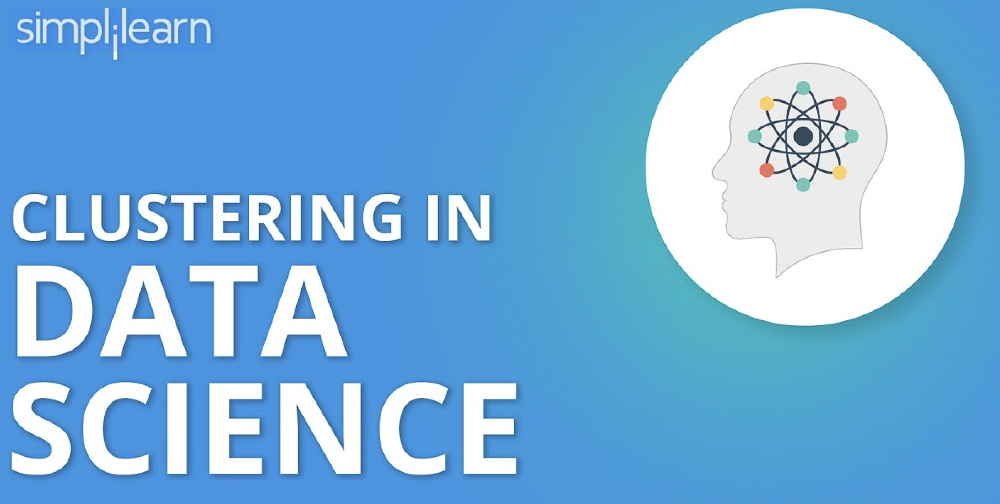

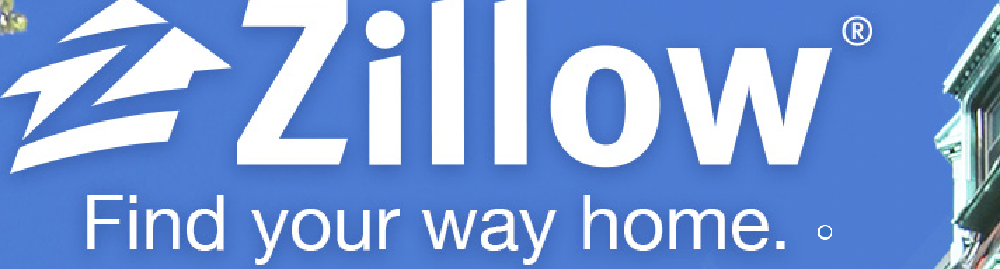

# Project Objectives

Document code, process (data acquistion, preparation, exploratory data analysis and statistical testing, modeling, and model evaluation), findings, and key takeaways in a Jupyter Notebook Final Report.

Create modules (acquire.py, prepare.py) that make your process repeateable and your report (notebook) easier to read and follow.

Ask exploratory questions of your data that will help you understand more about the attributes and drivers of log errors. Answer questions through charts and statistical tests.

Construct a model to predict assessed log error for single family properties using regression techniques.

Make recommendations to a data science team about how to improve predictions.

Refine your work into a Report, in the form of a jupyter notebook, that you will walk through in a 5 minute presentation to a group of collegues and managers about the work you did, why, goals, what you found, your methdologies, and your conclusions.

Be prepared to answer panel questions about your code, process, findings and key takeaways, and model.

# Business Goals:

My goal is to find key driver for log error in families property in 2017 using the zillow data 

Construct an ML Regression model that predict or lowers log errors('log_error') of Single Family Properties using attributes of the properties.

Find the key drivers of log error for single family properties.

Deliver a report that the data science team can read through and replicate, understand what steps were taken, why and what the outcome was.

Make recommendations on what works or doesn't work in prediction these homes' values.

# Questions:

• What effect log error on single families houses/properties?

• How does log error increase?

• Can we lower the chance of log error happening with single families properties?

# Steps:
1-Data acquistion 

2-Preparation

3-Exploratory data analysis 

3.2-Clusters exploration

4-Modeling 

5-Model evaluation

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

In [1]:
# Custom module imports
import acquire
import cluster
import prepare
import modeling 
# split data into train test val
from sklearn.model_selection import train_test_split

# 1)Acquire:

In [2]:
# Acquire data from sql using acquire.py
df=acquire.sqlclean_zillow()
df.shape

(52441, 13)

# keytake aways:

• 13 columns 

• total number of 52441 of single unit/single family homes

• all acquire from the 2017 data

• acquire from the codeup server using sql or csv 

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# 2)Prepare/Split:

In [3]:
#prepare zillow using sql in the prepare.py file
df=prepare.prep_zillow(df)

In [4]:
# splitting data into train, validate, test 60,20,20 using the prepare.py
train,val,test=prepare.my_train_test_split(df)
train.shape,val.shape,test.shape

((28263, 15), (9422, 15), (9422, 15))

In [5]:
#Creating a scaled of each split to prevent leaks and to create proper modeling.
cols_to_scale=['Bedrooms','Bathrooms','Squarefeet','TaxesTotal','Year','County','Zip','latitude',
               'longitude','TotalRooms','Decade','Taxamount','Log_error']
train_scaled, val_scaled, test_scaled = prepare.scale_data(train, val, test, cols_to_scale)

# Data Used-Zillow

|Attribute|Old keys|        Data type   |       Definition   |
| -------- |-------- | -------- | -------- | 
|Bedrooms |bedroomcnt|float |  Number of bedrooms in home |
|Bathrooms |bathroomcnt|float | Number of bathrooms in home including fractional bathrooms|
|Squarefeet |calculatedfinishedsquarefeet|float | Calculated total finished living area of the home |
|TaxesTotal |taxvaluedollarcnt|float|The total property tax assessed for that assessment year 
|Year |yearbuilt|float |The Year the principal residence was built  |
|county |regionidcounty |float |The total tax assessed value of the parcel|
|Zip|regionidzip|object | Federal Information Processing Standard code |
|latitude|latitude|float|cordinates
|longitude|longitude|float|cordinates
|TotalRooms|N/A|float|bathrooms and bedrooms combined 
|location|N/A|object|area houses are located in 
|Decade|N/A|int   |Years slice into half a centary|
|Fips|fips|float|area code
|Taxamount|taxcnt|float|total taxes value
|Log_error|logerror|float|error

# Prepare takeaways:

•Created 3 new columns----

Decade-split year into decade to shorten

Totalrooms-connect bedrooms and bathrooms together 

location-got the area code from county and split them up into Los angelos,ventura,orange

•Split the data into 60,20,20 train set

•Total number of columns 15


# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# 3)Exploration:

# Hypotheses:
`Hypothesis(1)-Does Los angelos county effect log error more the orange county?:`

Ho-Los angelos has a higer log error  then Orange county

Ha-Orange county has a higher log error then Los Angelos

`Hypothesis(2)-Does Ventura county effect log error more then Orange county?:`

Ho-Ventura county has a higher log error then Orange county 

Ha-Ventura county has a lower log error then Orange county


`Hypothesis(3)-Do Bedrooms have a big effect on log error:`

Ho-Does more Bed rooms increase the log error?

Ha-Bed rooms has no effect on log error 

`Hypothesis(4)-Do Bathrooms have a big effect on Log error:`

Ho-Does more bathrooms increase the amount of log error?

Ha-Bathrooms has no effect on the amount of log error

`Hypothesis(5)-Does logerror and squarefeet have a relationship?:`

Ho-Does Squarefeet effect log error ?

Ha-Squarefeet doesnt effect log error

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# `Hypothesis(1)-Does Los angelos county effect log error more the orange county?:`

Ho-Los angelos has a higher log error  then Orange county

Ha-Orange county has a higher log error then Los Angelos

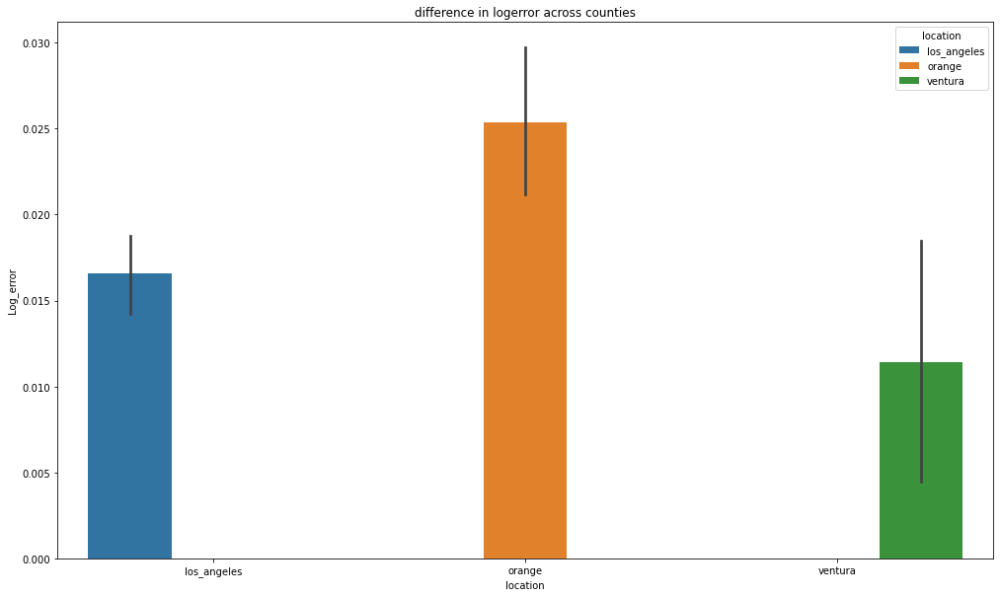

In [6]:
#orange has the highest logerror out of all of them aka countys
# graph location compared to log error using modeling.py/bar plot
modeling.county_log(train)

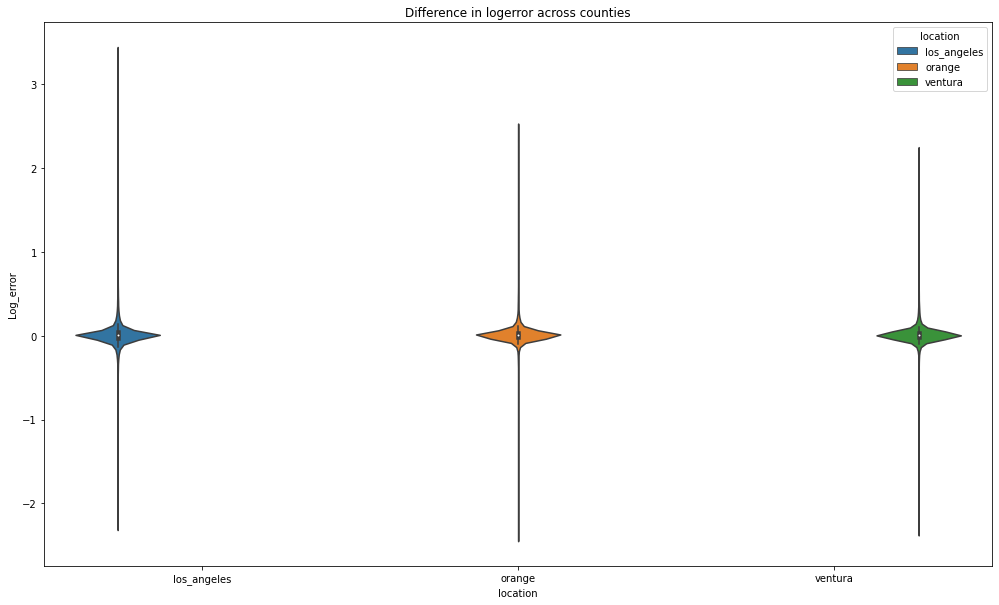

In [7]:
# graph location compared to log error using modeling.py/violinplot
modeling.county_log1(train)

In [8]:
#stats test/
modeling.location_stats(train)

LeveneResult(statistic=27.945934142123622, pvalue=1.2576297366438482e-07)
Ttest_indResult(statistic=-3.597971033243179, pvalue=0.00032195384394863644)


# keyfindings:

•Reject the null hypothesis and suggest there is significant difference between means of logerror between orange and Los angelos 

•Los angelos has second highest log error out of all of the countys

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# `Hypothesis(2)-Does Ventura county effect log error more then Orange county?:`

Ho-Ventura county has a higher log error then Orange county 

Ha-Ventura county has a lower log error then Orange county

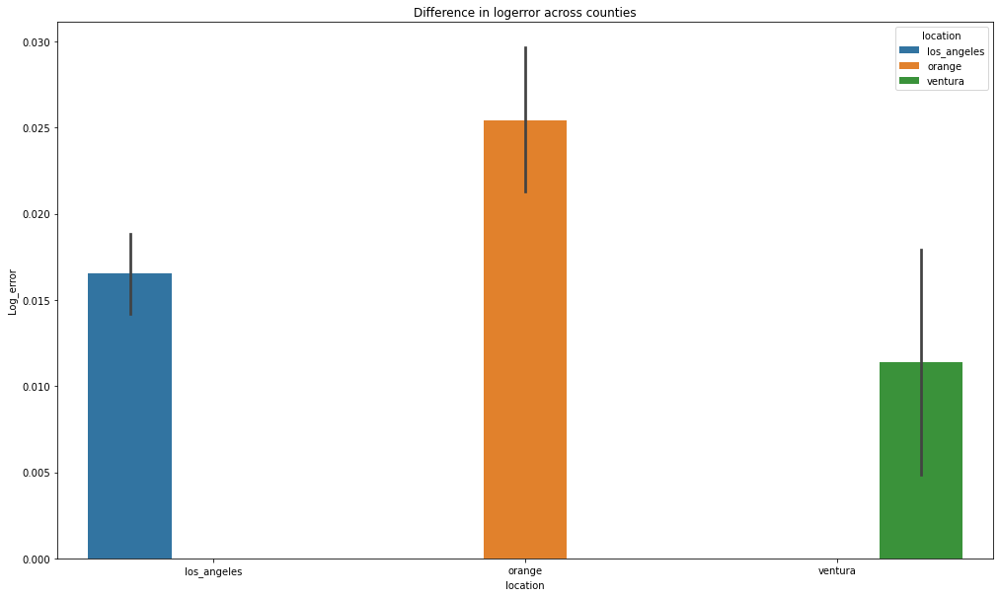

In [9]:
#orange has the highest logerror out of all of them aka countys
# graph location compared to log error using modeling.py/bar plot
modeling.county_log2(train)

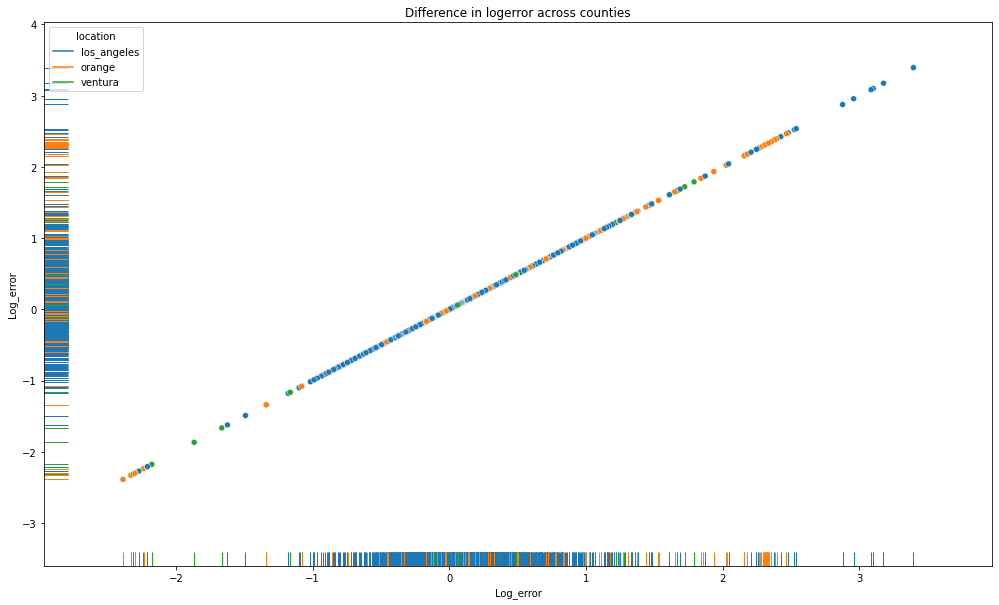

In [10]:
# graph location compared to log error using modeling.py
modeling.county_log3(train)

In [11]:
#stats test/
modeling.location_stats1(train)

LeveneResult(statistic=1.8922278151200627, pvalue=0.16898216183872783)
Ttest_indResult(statistic=-3.5007259283585466, pvalue=0.00046857946471683343)


# keyfindings:

•Reject the null hypothesis and suggest there is significant difference between means of logerror between orange and ventura

•Orange county has the less log error of all 3 countys

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# ``Hypothesis(3)-Do Bedrooms have a big effect on Log error?:`

Ho-Does more Bed rooms increase the log error?

Ha-Bed rooms has no effect on log error 

In [12]:
#modeling bedrooms compare to log error using modeling.py
modeling.bedrooms_log(train)

alt.VConcatChart(...)

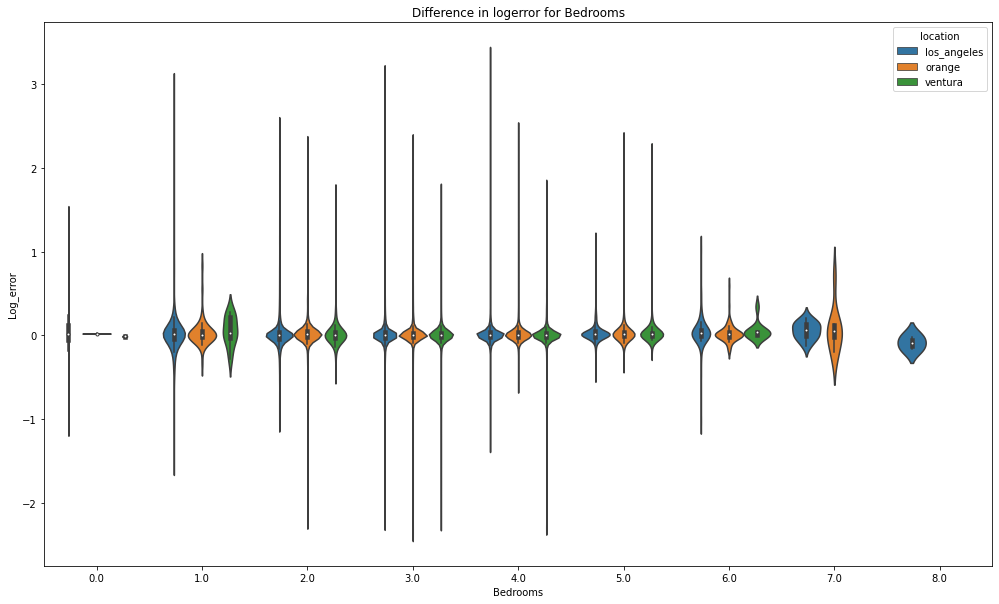

In [13]:
#modeling bedrooms compare to log error using modeling.py
modeling.bedrooms_log1(train)

In [14]:
#stats test/
modeling.bedrooms_stats(train)

We reject the null hypothesis
We can say that we have confidence that bedroom is related to log error


# takeaways:

•we can reject the null hypothese saying bedroom does effect log error

•Around 2 to 3 bedroom has a higher log error 

• log error is low around 6- 9 bedrooms

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# `Hypothesis(4)-Do Bathrooms have a big effect on Log error?:`

Ho-Does more bathrooms increase the amount of log error?

Ha-Bathrooms has no effect on the amount of log error?

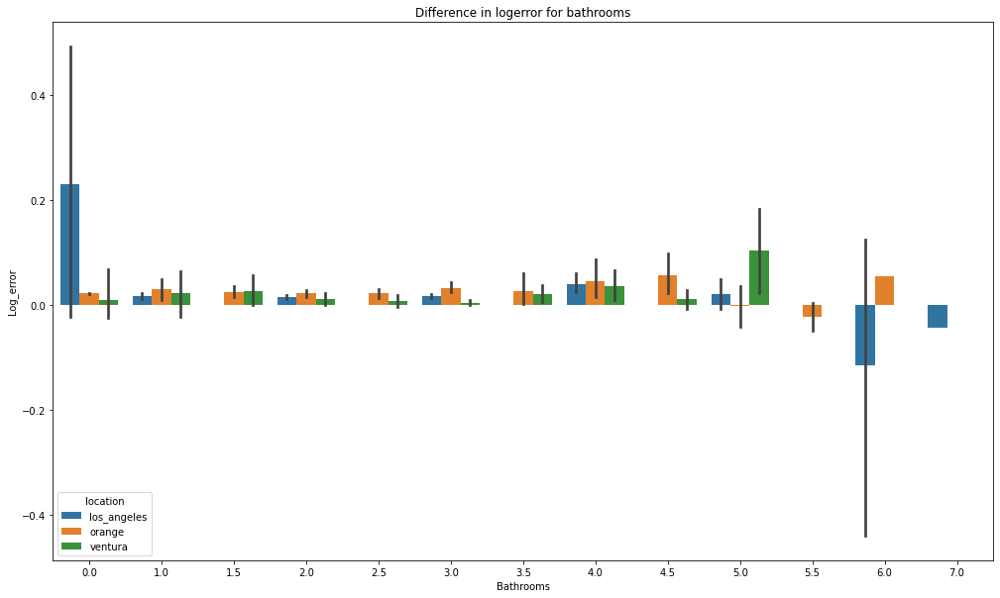

In [15]:
#modeling bathrooms compare to log error using modeling.py
modeling.bathrooms_log(train)

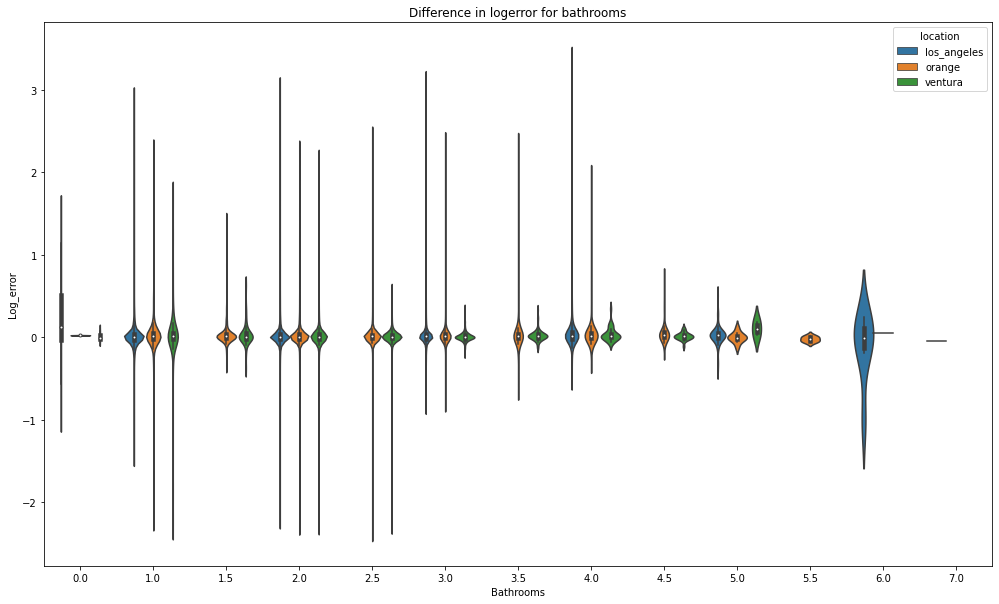

In [16]:
#modeling bathrooms compare to log error using modeling.py
modeling.bathrooms_log1(train)

In [17]:
#stats test/
modeling.bathrooms_stats(train)

We fail to reject the null


# takeaways:

• The more bathrooms less chances of log error ?

• Most log error happens around the 1 to 3.5 bathroom range 

• The highest log error of bathrooms is 1 bathroom

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# `Hypothesis(5)-Does logerror and squarefeet have a relationship?:`

Ho-Does Squarefeet effect log error ?

Ha-Squarefeet doesnt effect log error

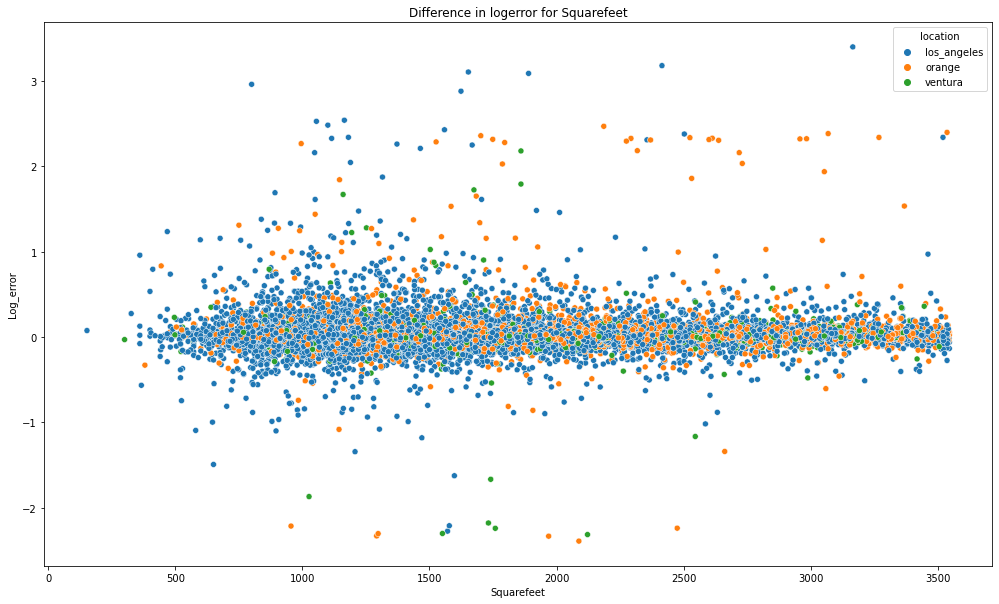

In [18]:
#modeling logerror and squarefeet using modeling.py
modeling.Squarefeet_log(train)

In [19]:
#modeling logerror and squarefeet using modeling.py
modeling.squarefeet_log1(train)

alt.VConcatChart(...)

In [20]:
#stats test/
modeling.squarefeet_stats(train)

We reject the null hypothesis
We can say that we have confidence that squarefeet is related to logerror


# takeaways:

• Los angelos has a biggest log error

• Los angelos has the more has more log error in the 500squarefeet to 2000 squarefeet areas

• orange county starts to control the log error around the 3300squarefeet to 3500squarefeet

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# 3.2)Clusters exploration:

# 1)Bedrooms and decade cluster:

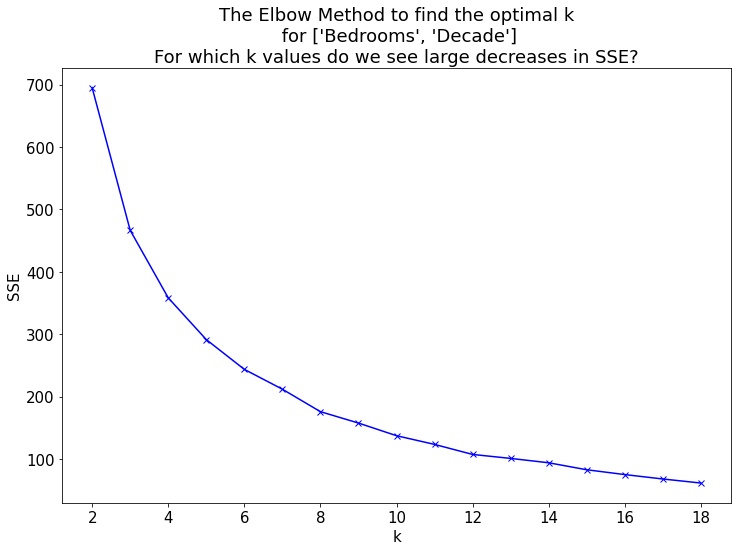

In [21]:
#elbow for bedrooms and decade compare to log error 
modeling.elbow_bed(train_scaled)

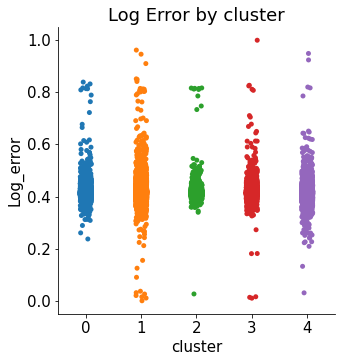

Clusters for Bedroom and Decade
H0:  The log error is not significantly different
Ha:  The logerrors is significantly different
We reject the Null Hypothesis


In [22]:
#created 5 clusters using bedrooms and decade
modeling.bedcluster_graph(train_scaled)

# Key takeaways:

• Cluster(1) is more group together 

• Cluster(3) is the worse grouping and has a outliar

• all cluster are group well to a certain extend

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# 2)Cluster created using TaxesTotal,Squarefeet

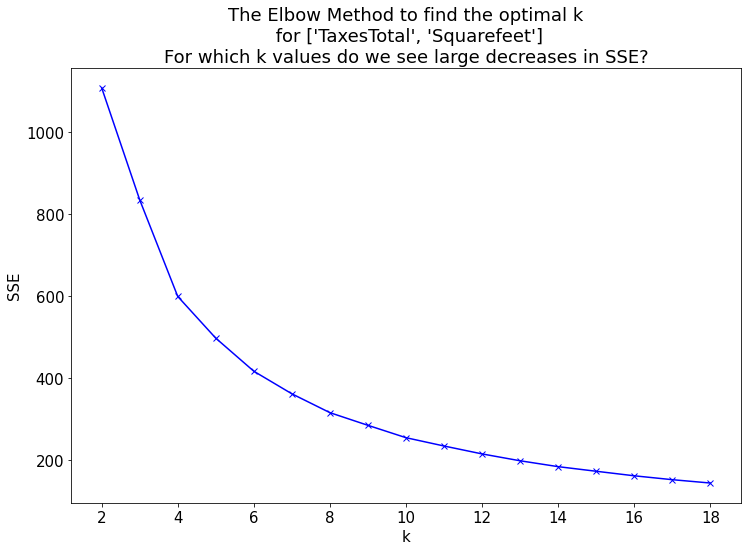

In [23]:
# creating elbow cluster using taxestotal and squarefeet
modeling.taxcluster_elbow(train_scaled)

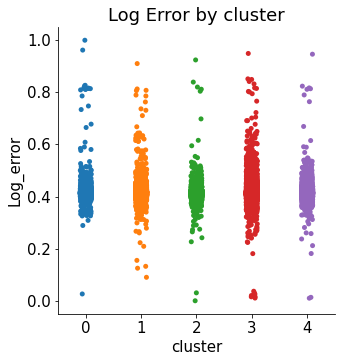

Clusters for TaxesTotal and Squarefeet
H0:  The log error is not significantly different
Ha:  The logerrors is significantly different
We reject the Null Hypothesis


In [24]:
# 5 clusters using taxestotal and squarefeet
modeling.taxcluster_graph(train_scaled)

# Key takeaways:

• Cluster(1) is connected or group the best 

• Worse group is cluster(3) because the random outliar 

• Cluster(4) is either group really well or the group is small 

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# 3)Cluster created using lat/long effect log error?

     k          sse
0    2  2018.819079
1    3  1608.958159
2    4  1308.490112
3    5  1156.054811
4    6  1023.592548
5    7   901.877828
6    8   819.112793
7    9   749.604073
8   10   704.809840
9   11   665.807334
10  12   630.457483
11  13   598.349304
12  14   568.391994


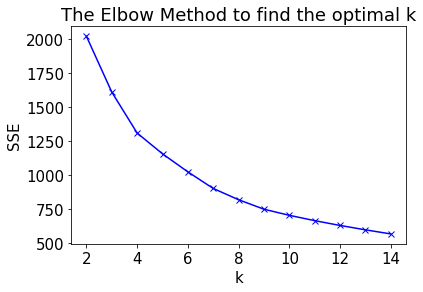

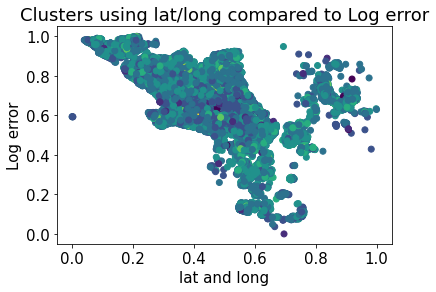

In [25]:
# clusters using lat and log 
modeling.longandlat(train_scaled,val_scaled,train,val)

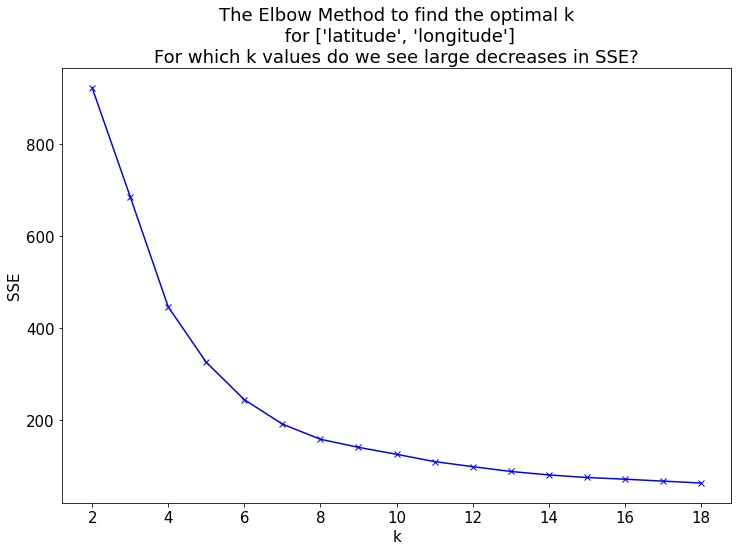

In [26]:
#elbow for lat and long
modeling.elbow_lat(train_scaled)

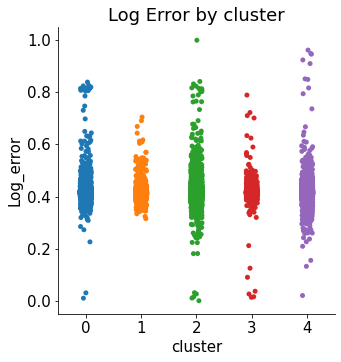

Clusters for lat and long
H0:  The log error is not significantly different
Ha:  The logerrors is significantly different
We reject the Null Hypothesis


In [27]:
# 5 cluster lat and long 
modeling.latcluster_lat(train_scaled)

# Exploration key takeaways:

• All of the following driver we pulled effect log error(bedroom,bathrooms,taxestotal,squarefeet,decade,location)

• Los angelos has terrible log error most likely because theyve a higher count of house

• Orange log error is the lowest out of all the locations

• Bathroom effect log error more the bedrooms.

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# 4)Modeling:

Use selected features or clustered data to predict the target logerror

Algorithms used:

•LassoLars Model

•Polynomial Models depth(1)

•Polynomial Models depth(2)

•Polynomial Models depth(3)

•Polynomial Models depth(4)

Data for modeling:

all select features via clustering and clusters generated using selected features

Best model:

•best model is Polynomial model at depth(2)

In [6]:
# Create the X and y for train, validate, and test
# Get it ready for modeling
X_train, y_train, X_val, y_val, X_test, y_test = prepare.model_setup(train_scaled, train, val_scaled, val, test_scaled, test)

In [7]:
# Get the modeling results, PolynomialFeatures, lars model
metrics = modeling.Modeling_function(X_train, y_train, X_val, y_val)
metrics

,Model,Train_rmse,Train_r2,Val_rmse,Val_r2
0,baseline_mean,0.169201,0.000000,0.155290,0.000000
1,Lars_alpha(2),0.169201,0.000000,0.155290,0.000000
2,Depth(1),0.169032,0.001990,0.155020,0.003439
3,Depth(2),0.168615,0.006912,0.158486,-0.041656
4,Depth(3),0.167665,0.018067,0.826171,-27.312878
5,Depth(4),0.167879,0.015562,0.240463,-1.398220


# Modeling takeaways:

• Overfit depth 3 and 4 to much so the val rmse become higher then the train rmse

• Baseline r^2 = 0

• best model is Polynomial model at depth(2)

# <hr style="border-bottom: 10px groove brown; margin-top: 1px; margin-bottom: 1px"></hr>

# 5)Model evaluation:

In [8]:
# Test the best model
modeling.modeling_best(X_train, y_train, X_val, y_val, X_test, y_test)

,test
Test_r2,0.002540
Test_rmse,0.170413


# Conclusion/Recommnedations/Next Steps:
`Conclusion:`

• We could conclude that bedrooms,bathrooms,decade,county,location,squarefeet have a effect on log error

• In conclusion log error could be effect by many columns and many things so what should we do ?

• We could conclude that the Polynomial Modellinear regression model perform the best with a Test_rmse	0.170413

• Log error could be effected by many columns but bathroooms seem to have high effect on log error around the 4-6 bathroom range


`Recommendations:`

•Addding more data about the areas surronding the houses for example School,Malls,parks,rivers,lakes,hills,views, and much more so would could obtain a more accurate model.

•Would love to keep the cost of something the same but when something is in high demand usually means more houses would sell meaning more log error to happened. 

`Next Steps:`

• I would love to dive into more column in the zillow data set. How a room squarefeet could effect log error more then a basic rooom or how a garage could add more log error then a pool??. This data has so much potential but i would just be digging myself into a rabbit hole.

• I would check 2018 and see how much log error has change from the 2017 data of single families houses

• How bad was log error in the past or in the future?? did log error change much??

# Steps to reproduce finalnotebook:
zillow data set was collected from codeup server.Using this data to find key driver for log error while using clusters 

1)Download the following files 

• Acquire.py

• Prepare.py

• Modeling.py

• Cluster.py

• finalnotebook.pynd

2) After downloading files make sure all files are in the same folder or location 

3) Onces step two and step one are done you would be able to run finalnotebook without errors and on your own 

# Deliverables:
To access the correct MySQL database, you will need credentials to access to the CodeUp database. This database is accessed in this project via an env.py file. Add the below to your env.py and fill in your individual access information as strings:

user = 'your_user_name'
password = 'your_password'
host = 'the_codeup_db'

1-Readme (.md)-uses as a guide 

2-Acquire (.py)-download

3-Modeling (.py)-download

4-Prepare (.py)-download

5-cluster (.py)-download

6-Final Report (.ipynb)-download 